In [184]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn import preprocessing
import pandas as pd


# Read trained data 

In [185]:
# Training data
data_train = np.load('s1_train.npy',allow_pickle=True)
data_test  = np.load('s1_test.npy' ,allow_pickle=True)


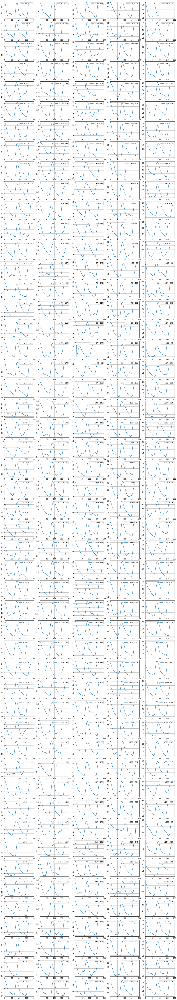

In [186]:
#Ploting data sample s0-s249
i=0
fig,ax=plt.subplots(50,5,figsize=(20,120))
for r in range(0,50):
    for c in range(0,5):
        ax[r,c].plot(data_train[i][0])
        ax[r,c].grid(True)
        ax[r,c].legend(['s %d = %d'%(i,data_train[i][1])],loc ="upper right"),
        ax[r,c].set_xlim(0,200)
        #ax[r,c].set_ylim(1,3)
        i=i+1


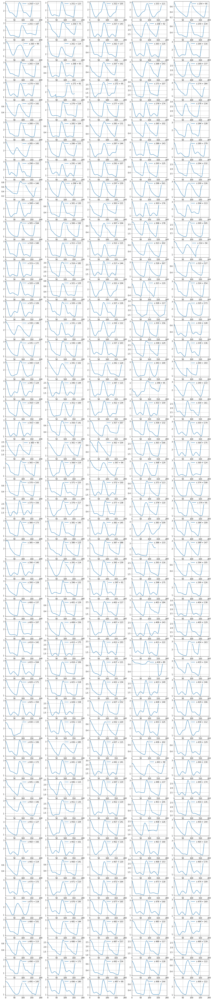

In [187]:
#ploting data s250-s499
i=250
fig,ax=plt.subplots(50,5,figsize=(20,100))
for r in range(0,50):
    for c in range(0,5):
        ax[r,c].plot(data_train[i][0])
        ax[r,c].grid(True)
        ax[r,c].legend(['s %d = %d'%(i,data_train[i][1])],loc ="upper right")
        ax[r,c].set_xlim(0,200)
        #ax[r,c].set_ylim(1,3)
        i=i+1

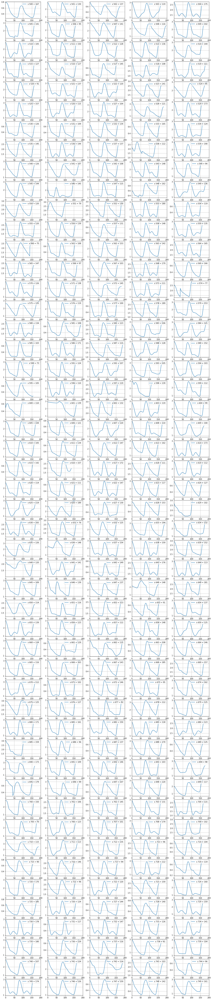

In [188]:
#ploting data s500-s749
i=500
fig,ax=plt.subplots(50,5,figsize=(20,100))
for r in range(0,50):
    for c in range(0,5):
        ax[r,c].plot(data_train[i][0])
        ax[r,c].grid(True)
        ax[r,c].legend(['s %d = %d'%(i,data_train[i][1])],loc ="upper right")
        ax[r,c].set_xlim(0,200)
        #ax[r,c].set_ylim(1,3)
        i=i+1

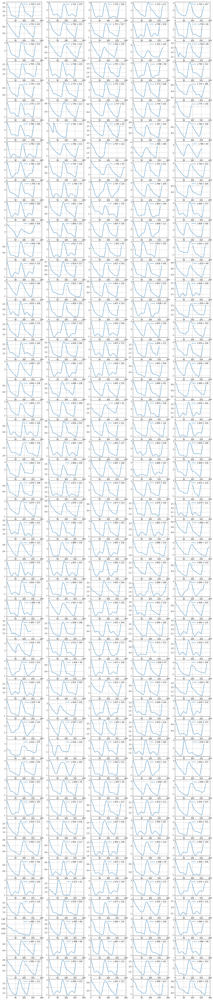

In [189]:
#ploting data s750-s999
i=750
fig,ax=plt.subplots(50,5,figsize=(20,100))
for r in range(0,50):
    for c in range(0,5):
        ax[r,c].plot(data_train[i][0])
        ax[r,c].grid(True)
        ax[r,c].legend(['s %d = %d'%(i,data_train[i][1])],loc ="upper right")
        ax[r,c].set_xlim(0,200)
        #ax[r,c].set_ylim(1,3)
        i=i+1

# Removing some of the trained data 

901


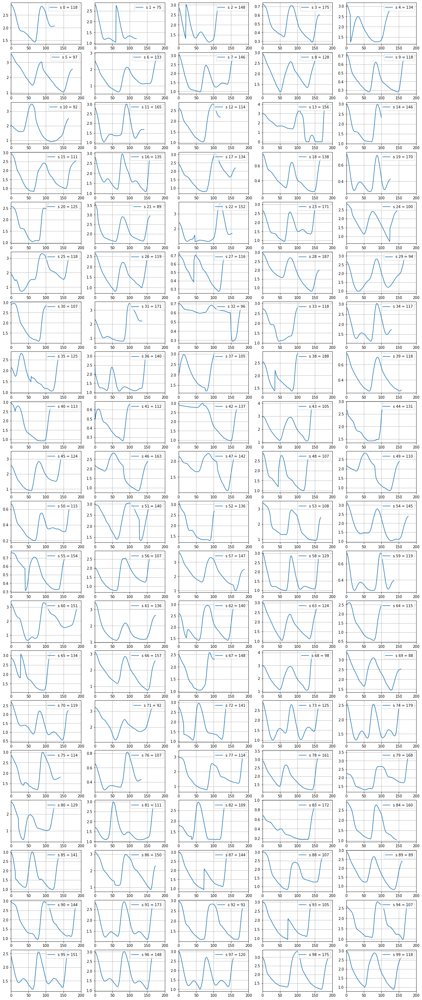

In [190]:
# Removing some of the trained data 

remove=[1,4,43,44,87,96,110,122,139,155,166,190,191,208,210,211,212,219,227,235,240,261,271,304,314,348,360
       ,362,367,383,385,388,418,430,460,538,546,551,574,595,598,600,601,626,629,635,636,640,646,648,661,675
       ,685,690,694,695,699,710,724,731,742,763,764,762,779,781,786,787,788,789,802,805,813,815,824,905,913
       ,919,926,935,936,939,971,980,982,987,274,344,357,978]
n=0
for i in range(0,len(data_train)):
    if (data_train[i][1]<70 or data_train[i][1]>190):
        remove.append(i)  
        n=n+1
new_data_train = np.delete(data_train,remove, axis=0)
#ploting removed data
i=0
fig,ax=plt.subplots(20,5,figsize=(20,50))
for r in range(0,20):
    for c in range(0,5):
        ax[r,c].plot(data_train[remove[i]][0])
        ax[r,c].grid(True)
        ax[r,c].legend(['s %d = %d'%(i,data_train[i][1])],loc ="upper right")
        ax[r,c].set_xlim(0,200)
        #ax[r,c].set_ylim(1,3)
        i=i+1

print(len(new_data_train))

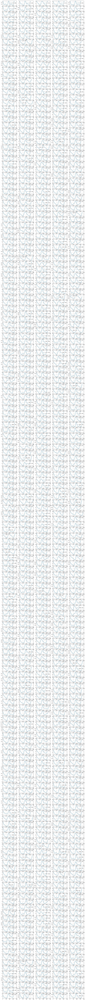

In [191]:
#ploting new dataset
i=0
fig,ax=plt.subplots(180,5,figsize=(20,250))
for r in range(0,180):
    for c in range(0,5):
        if i<len(new_data_train):
            ax[r,c].plot(new_data_train[i][0])
            ax[r,c].grid(True)
            ax[r,c].legend(['s %d = %d'%(i,new_data_train[i][1])])
            ax[r,c].set_xlim(0,200)
            #ax[r,c].set_ylim(1,3)
        i=i+1

# Basic Model

In [192]:
# Avarage
s=0
for i in range(0,len(new_data_train)):
    s=s+new_data_train[i][1]
mean_value=s/len(new_data_train)
print('Average of Labels of trained data = %f'%(mean_value))  

SST=0
for data in range(0,len(new_data_train)):
    SST=(new_data_train[data][1]-mean_value)**2+SST
T_SST=SST
print("Total sum of squer for data_test(SST)=%f"%(SST))
print('SSE/n=%f'%(SST/len(new_data_train)))
        

Average of Labels of trained data = 130.492432
Total sum of squer for data_test(SST)=546755.116243
SSE/n=606.831428


# Main Model

In [193]:
#Creating Dataset with same length
length=[]
for i in range(0,len(new_data_train )):
    length.append(len(new_data_train [i][0]))
print('Max length=',max(length)) 

arr=[0]*len(new_data_train)
for data in range(0,len(new_data_train)):
    x=np.linspace(0,len(new_data_train [data][0])-1,len(new_data_train [data][0]))
    y=new_data_train [data][0]
    add=max(length)-len(new_data_train [data][0])
    mymodel = np.poly1d(np.polyfit(x, y,2))
    l=[]
    for i in range(len(new_data_train [data][0]),max(length)):
        l.append(mymodel(i))
    arr[data] = np.concatenate((new_data_train [data][0].tolist(), l))



Max length= 199


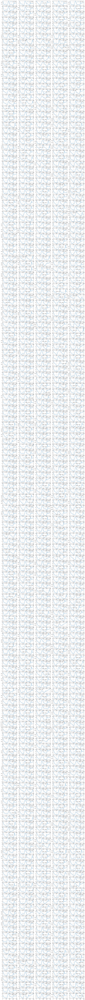

In [194]:
#ploting new dataset (they have same length)
i=0
fig,ax=plt.subplots(180,5,figsize=(20,250))
for r in range(0,180):
    for c in range(0,5):
        if i<len(arr):
            ax[r,c].plot(arr[i])
            ax[r,c].grid(True)
            ax[r,c].legend(['s %d = %d'%(i,new_data_train[i][1])])
            ax[r,c].set_xlim(0,200)
            #ax[r,c].set_ylim(1,3)
        i=i+1
        

In [195]:
# All Data that we can use
sample=['sample'+str(i) for i in range(0,len(new_data_train))]
p=['p'+str(i) for i in range(0,max(length))]
lable=['Label'+str(i) for i in range(0,1)]
data=pd.DataFrame(columns=[*p,*lable])
for i in range(0,len(new_data_train)):
    for j in range(0,len(arr[i])):
        data.loc[i,'p'+str(j)]=arr[i][j]
    data.loc[i,'Label0']=new_data_train[i][1]

#print(data.head())
#print(data.shape)
data

,p0,p1,p2,p3,p4,p5,p6,p7,p8,p9,...,p190,p191,p192,p193,p194,p195,p196,p197,p198,Label0
0,0.752688,0.752688,0.744868,0.73216,0.714565,0.695015,0.673509,0.648094,0.618768,0.58651,...,0.505702,0.508403,0.511133,0.513892,0.51668,0.519497,0.522343,0.525218,0.528122,118.853
1,2.7869,2.77126,2.73509,2.68524,2.62854,2.56891,2.50733,2.44477,2.38025,2.31476,...,1.86988,1.87527,1.88074,1.88626,1.89186,1.89752,1.90324,1.90903,1.91489,148.017
2,3.08895,3.08407,3.07625,3.06061,3.03715,3.00587,2.96579,2.91691,2.86217,2.80254,...,2.51571,2.53143,2.54731,2.56337,2.57959,2.59598,2.61254,2.62926,2.64615,175.509
3,2.85826,2.85435,2.83187,2.79374,2.74291,2.68133,2.61779,2.55132,2.4741,2.38807,...,2.09004,2.09903,2.10812,2.1173,2.12657,2.13593,2.14539,2.15494,2.16459,97.0844
4,0.729228,0.723363,0.714565,0.701857,0.686217,0.670577,0.652981,0.636364,0.618768,0.600196,...,0.552357,0.555463,0.5586,0.561767,0.564965,0.568194,0.571453,0.574742,0.578062,133.855
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
896,2.8827,2.8739,2.85826,2.83382,2.79961,2.75464,2.70088,2.6393,2.57087,2.49951,...,2.89107,2.9096,2.92829,2.94714,2.96614,2.98531,3.00464,3.02413,3.04377,111.875
897,3.0088,3.00587,2.9824,2.94135,2.88563,2.81818,2.74194,2.65787,2.57771,2.49853,...,2.29986,2.31484,2.32997,2.34525,2.36069,2.37627,2.392,2.40789,2.42392,132.446
898,0.669599,0.667644,0.663734,0.657869,0.651026,0.642229,0.633431,0.624633,0.616813,0.608016,...,0.546927,0.549381,0.551862,0.554369,0.556904,0.559465,0.562053,0.564668,0.567309,137.527
899,2.86608,2.85533,2.83871,2.81623,2.78886,2.75758,2.72336,2.68817,2.652,2.61584,...,1.54151,1.54479,1.54815,1.55158,1.55508,1.55866,1.56231,1.56604,1.56984,153.582


In [196]:
#PCA
# Separating out the features
x = data.loc[:, p].values
# Separating out the target
y = data.loc[:,['Label0']].values
# Standardizing the features
x = StandardScaler().fit_transform(x)
N=10
pca = PCA(n_components=N)
principalComponents = pca.fit_transform(x)
feature_pca=['pca'+str(i) for i in range(0,N)]
principalDf = pd.DataFrame(data = principalComponents, columns = [*feature_pca])

finalDf = pd.concat([principalDf,data[['Label0']]], axis = 1)

In [197]:
finalDf

,pca0,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,Label0
0,27.657816,-0.182116,-0.307610,0.152775,-0.385740,-0.760963,0.397760,0.289842,-0.345196,-0.091299,118.853
1,-4.020641,0.331350,3.374356,-1.454093,-0.954007,-2.155014,-0.157367,-1.368452,-0.006668,-0.076299,148.017
2,-10.193119,-0.477015,3.212936,-4.279581,1.292642,1.982948,0.954196,1.280558,0.972704,0.292370,175.509
3,-4.815659,-1.919177,2.311579,-2.293960,-0.659596,-1.854911,-0.177950,-1.414513,0.566469,0.320270,97.0844
4,27.395780,-1.289453,0.487793,0.362844,0.298565,-0.358636,-0.109768,-0.276703,-0.085814,-0.036825,133.855
...,...,...,...,...,...,...,...,...,...,...,...
896,-13.787568,-6.324331,-0.630359,6.625869,2.153120,-1.376832,2.621947,1.639913,-1.750235,2.345212,111.875
897,-5.109305,-5.189700,-1.810200,0.269243,-2.280843,-1.787119,-0.813836,0.136414,0.611364,0.918504,132.446
898,26.448993,-0.243996,1.010577,0.527009,0.270242,0.042218,0.408455,0.457123,0.092666,0.104884,137.527
899,-2.690656,7.800011,0.856159,-0.495765,-1.416700,2.927957,-1.927945,-1.940337,0.101140,1.382532,153.582


# 10_fold Cross Validation

In [198]:
# 10_fold Cross Validation
x1_test =finalDf.loc[0:89, feature_pca].values
y1_test =finalDf.loc[0:89,['Label0']].values
x1_Train=finalDf.loc[90:, feature_pca].values
y1_Train=finalDf.loc[90:,['Label0']].values

l1=[i for i in range(0,90)]
l2=[i for i in range(180,900)]
l_Train=np.concatenate((l1, l2))
x2_test =finalDf.loc[90:179, feature_pca].values
y2_test =finalDf.loc[90:179,['Label0']].values
x2_Train=finalDf.loc[l_Train, feature_pca].values
y2_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,180)]
l2=[i for i in range(270,900)]
l_Train=np.concatenate((l1, l2))
x3_test =finalDf.loc[180:269, feature_pca].values
y3_test =finalDf.loc[180:269,['Label0']].values
x3_Train=finalDf.loc[l_Train, feature_pca].values
y3_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,270)]
l2=[i for i in range(360,900)]
l_Train=np.concatenate((l1, l2))
x4_test =finalDf.loc[270:359, feature_pca].values
y4_test =finalDf.loc[270:359,['Label0']].values
x4_Train=finalDf.loc[l_Train, feature_pca].values
y4_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,360)]
l2=[i for i in range(450,900)]
l_Train=np.concatenate((l1, l2))
x5_test =finalDf.loc[360:449, feature_pca].values
y5_test =finalDf.loc[360:449,['Label0']].values
x5_Train=finalDf.loc[l_Train, feature_pca].values
y5_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,450)]
l2=[i for i in range(540,900)]
l_Train=np.concatenate((l1, l2))
x6_test =finalDf.loc[450:539, feature_pca].values
y6_test =finalDf.loc[450:539,['Label0']].values
x6_Train=finalDf.loc[l_Train, feature_pca].values
y6_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,540)]
l2=[i for i in range(630,900)]
l_Train=np.concatenate((l1, l2))
x7_test =finalDf.loc[540:629, feature_pca].values
y7_test =finalDf.loc[540:629,['Label0']].values
x7_Train=finalDf.loc[l_Train, feature_pca].values
y7_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,630)]
l2=[i for i in range(720,900)]
l_Train=np.concatenate((l1, l2))
x8_test =finalDf.loc[630:719, feature_pca].values
y8_test =finalDf.loc[630:719,['Label0']].values
x8_Train=finalDf.loc[l_Train, feature_pca].values
y8_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,720)]
l2=[i for i in range(810,900)]
l_Train=np.concatenate((l1, l2))
x9_test =finalDf.loc[720:809, feature_pca].values
y9_test =finalDf.loc[720:809,['Label0']].values
x9_Train=finalDf.loc[l_Train, feature_pca].values
y9_Train=finalDf.loc[l_Train,['Label0']].values

l1=[i for i in range(0,810)]
x10_test =finalDf.loc[810:899, feature_pca].values
y10_test =finalDf.loc[810:899,['Label0']].values
x10_Train=finalDf.loc[l1, feature_pca].values
y10_Train=finalDf.loc[l1,['Label0']].values




# Iteration 1,Systolic

In [199]:
# First iteration,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 1,Systolic')
print('------------------------------------------')
print('\n')
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x1_Train, y1_Train)
y_lin_pred=lin.predict(x1_test)
SSE_li1=0
for i in range(0,len(y_lin_pred)):
    SSE_li1=(y1_test[i][0]-y_lin_pred[i])**2+SSE_li1
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li1))
print('SSE/n = %f'%(SSE_li1/len(y_lin_pred)))
print('\n')


# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree =2)
X_poly = poly.fit_transform(x1_Train)
poly.fit(X_poly, y1_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y1_Train)
X_poly_test = poly.fit_transform(x1_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE1=0
for i in range(0,len(y_poly_pred)):
    SSE1=(y1_test[i][0]-y_poly_pred[i])**2+SSE1
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE1))
print('SSE/n = %f'%(SSE1/len(y_poly_pred)))
print('\n')
#cp1=SSE1/len(y_poly_pred)
# Avarage
s1=0
for i in range(0,len(y1_Train)):
    s1=s1+y1_Train[i]
mean_value1=s1/len(y1_Train)
print("SST for Iteration 1")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 1 = %f'%(mean_value1))  

SST1=0
for i in range(0,len(y1_test)):
    SST1=(y1_test[i][0]-mean_value1)**2+SST1
print("Total Sum of Squer(SST) for data_test=%f"%(SST1))
print('SST/n=%f'%(SST1/len(y1_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE1/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li1/T_SST))


Iteration 1,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 54268.783005
SSE/n = 602.986478


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 48638.882455 
SSE/n = 540.432027


SST for Iteration 1
-----------------------------------------
Average of labels of Trained Data of Iteration 1 = 130.507444
Total Sum of Squer(SST) for data_test=56319.672639
SST/n=625.774140


R^2
----------------------
polynomial Regression
R^2=0.911041


Linear Regression
R^2=0.900744


# Iteration 2,Systolic

In [200]:
# iteration 2,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 2,Systolic')
print('------------------------------------------')
print('\n')
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x2_Train, y2_Train)
y_lin_pred=lin.predict(x2_test)
SSE_li2=0
for i in range(0,len(y_lin_pred)):
    SSE_li2=(y2_test[i][0]-y_lin_pred[i])**2+SSE_li2
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li2))
print('SSE/n = %f'%(SSE_li2/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x2_Train)
poly.fit(X_poly, y2_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y2_Train)
X_poly_test = poly.fit_transform(x2_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE2=0
for i in range(0,len(y_poly_pred)):
    SSE2=(y2_test[i][0]-y_poly_pred[i])**2+SSE2
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE2))
print('SSE/n = %f'%(SSE2/len(y_poly_pred)))
print('\n')

# Avarage
s2=0
for i in range(0,len(y2_Train)):
    s2=s2+y2_Train[i]
mean_value2=s2/len(y2_Train)
print("SST for Iteration 2")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 2 = %f'%(mean_value2))  

SST2=0
for i in range(0,len(y2_test)):
    SST2=(y2_test[i][0]-mean_value2)**2+SST2
print("Total Sum of Squer(SST) for data_test=%f"%(SST2))
print('SST/n=%f'%(SST2/len(y2_test)))
#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE2/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li2/T_SST))

Iteration 2,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 58553.366640
SSE/n = 650.592963


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 52679.486937 
SSE/n = 585.327633


SST for Iteration 2
-----------------------------------------
Average of labels of Trained Data of Iteration 2 = 130.398601
Total Sum of Squer(SST) for data_test=55880.528123
SST/n=620.894757


R^2
----------------------
polynomial Regression
R^2=0.903651


Linear Regression
R^2=0.892908


# Iteration 3,Systolic

In [201]:
# iteration 3,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 3,Systolic')
print('------------------------------------------')
print('\n')
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x3_Train, y3_Train)
y_lin_pred=lin.predict(x3_test)
SSE_li3=0
for i in range(0,len(y_lin_pred)):
    SSE_li3=(y3_test[i][0]-y_lin_pred[i])**2+SSE_li3
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li3))
print('SSE/n = %f'%(SSE_li3/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x3_Train)
poly.fit(X_poly, y3_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y3_Train)
X_poly_test = poly.fit_transform(x3_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE3=0
for i in range(0,len(y_poly_pred)):
    SSE3=(y3_test[i][0]-y_poly_pred[i])**2+SSE3
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f "%(SSE3))
print('SSE/n = %f'%(SSE3/len(y_poly_pred)))
print('\n')

# Avarage
s3=0
for i in range(0,len(y3_Train)):
    s3=s3+y3_Train[i]
mean_value3=s3/len(y3_Train)
print("SST for Iteration 3")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 3 = %f'%(mean_value3))  

SST3=0
for i in range(0,len(y3_test)):
    SST3=(y3_test[i][0]-mean_value3)**2+SST3

print("Total Sum of Squer(SST) for data_test=%f"%(SST3))
print('SST/n=%f'%(SST3/len(y3_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE3/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li3/T_SST))

Iteration 3,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 50079.081347
SSE/n = 556.434237


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer Error(SSE) for data_test = 51890.113371 
SSE/n = 576.556815


SST for Iteration 3
-----------------------------------------
Average of labels of Trained Data of Iteration 3 = 130.692676
Total Sum of Squer(SST) for data_test=50508.077641
SST/n=561.200863


R^2
----------------------
polynomial Regression
R^2=0.905094


Linear Regression
R^2=0.908407


# Iteration 4,Systolic

In [202]:
# iteration 4,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 4,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x4_Train, y4_Train)
y_lin_pred=lin.predict(x4_test)
SSE_li4=0
for i in range(0,len(y_lin_pred)):
    SSE_li4=(y4_test[i][0]-y_lin_pred[i])**2+SSE_li4
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li4))
print('SSE/n = %f'%(SSE_li4/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x4_Train)
poly.fit(X_poly, y4_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y4_Train)
X_poly_test = poly.fit_transform(x4_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE4=0
for i in range(0,len(y_poly_pred)):
    SSE4=(y4_test[i][0]-y_poly_pred[i])**2+SSE4
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f "%(SSE4))
print('SSE/n = %f'%(SSE4/len(y_poly_pred)))
print('\n')

# Avarage
s4=0
for i in range(0,len(y4_Train)):
    s4=s4+y4_Train[i]
mean_value4=s4/len(y4_Train)
print("SST for Iteration 4")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 4 = %f'%(mean_value4))  

SST4=0
for i in range(0,len(y4_test)):
    SST4=(y4_test[i][0]-mean_value4)**2+SST4
print("Total Sum of Squer(SST) for data_test=%f"%(SST4))
print('SST/n=%f'%(SST4/len(y4_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE4/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li4/T_SST))

Iteration 4,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 50491.134505
SSE/n = 561.012606


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer Error(SSE) for data_test = 58808.528062 
SSE/n = 653.428090


SST for Iteration 4
-----------------------------------------
Average of labels of Trained Data of Iteration 4 = 129.968261
Total Sum of Squer(SST) for data_test=54237.594475
SST/n=602.639939


R^2
----------------------
polynomial Regression
R^2=0.892441


Linear Regression
R^2=0.907653


# Iteration 5,Systolic

In [203]:
# iteration 5,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 5,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x5_Train, y5_Train)
y_lin_pred=lin.predict(x5_test)
SSE_li5=0
for i in range(0,len(y_lin_pred)):
    SSE_li5=(y5_test[i][0]-y_lin_pred[i])**2+SSE_li5
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li5))
print('SSE/n = %f'%(SSE_li5/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x5_Train)
poly.fit(X_poly, y5_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y5_Train)
X_poly_test = poly.fit_transform(x5_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE5=0
for i in range(0,len(y_poly_pred)):
    SSE5=(y5_test[i][0]-y_poly_pred[i])**2+SSE5
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE5))
print('SSE/n = %f'%(SSE5/len(y_poly_pred)))
print('\n')

# Avarage
s5=0
for i in range(0,len(y5_Train)):
    s5=s5+y5_Train[i]
mean_value5=s5/len(y5_Train)
print("SST for Iteration 5")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 5 = %f'%(mean_value5))  

SST5=0
for i in range(0,len(y5_test)):
    SST5=(y5_test[i][0]-mean_value5)**2+SST5
print("Total Sum of Squer(SST) for data_test=%f"%(SST5))
print('SST/n=%f'%(SST3/len(y5_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE5/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li5/T_SST))

Iteration 5,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 45230.208134
SSE/n = 502.557868


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 47348.701334 
SSE/n = 526.096681


SST for Iteration 5
-----------------------------------------
Average of labels of Trained Data of Iteration 5 = 129.905720
Total Sum of Squer(SST) for data_test=48444.456944
SST/n=561.200863


R^2
----------------------
polynomial Regression
R^2=0.913401


Linear Regression
R^2=0.917275


# Iteration 6,Systolic

In [204]:
# iteration 6,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 6,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x6_Train, y6_Train)
y_lin_pred=lin.predict(x6_test)
SSE_li6=0
for i in range(0,len(y_lin_pred)):
    SSE_li6=(y6_test[i][0]-y_lin_pred[i])**2+SSE_li6
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li6))
print('SSE/n = %f'%(SSE_li6/len(y_lin_pred)))
print('\n')


# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x6_Train)
poly.fit(X_poly, y6_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y6_Train)
X_poly_test = poly.fit_transform(x6_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE6=0
for i in range(0,len(y_poly_pred)):
    SSE6=(y6_test[i][0]-y_poly_pred[i])**2+SSE6
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE6))
print('SSE/n = %f'%(SSE6/len(y_poly_pred)))
print('\n')

# Avarage
s6=0
for i in range(0,len(y6_Train)):
    s6=s6+y6_Train[i]
mean_value6=s6/len(y6_Train)
print("SST for Iteration 6")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 6 = %f'%(mean_value6))
SST6=0
for i in range(0,len(y6_test)):
    SST6=(y6_test[i][0]-mean_value6)**2+SST6
print("Total Sum of Squer(SST) for data_test=%f"%(SST6))
print('SST/n=%f'%(SST6/len(y6_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE6/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li6/T_SST))

Iteration 6,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 48524.020887
SSE/n = 539.155788


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 49980.797553 
SSE/n = 555.342195


SST for Iteration 6
-----------------------------------------
Average of labels of Trained Data of Iteration 6 = 130.384332
Total Sum of Squer(SST) for data_test=49287.205181
SST/n=547.635613


R^2
----------------------
polynomial Regression
R^2=0.908587


Linear Regression
R^2=0.911251


# Iteration 7,Systolic

In [205]:
# iteration 7,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 7,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x7_Train, y7_Train)
y_lin_pred=lin.predict(x7_test)
SSE_li7=0
for i in range(0,len(y_lin_pred)):
    SSE_li7=(y7_test[i][0]-y_lin_pred[i])**2+SSE_li7
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li7))
print('SSE/n = %f'%(SSE_li7/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x7_Train)
poly.fit(X_poly, y7_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y7_Train)
X_poly_test = poly.fit_transform(x7_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE7=0
for i in range(0,len(y_poly_pred)):
    SSE7=(y7_test[i][0]-y_poly_pred[i])**2+SSE7
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE7))
print('SSE/n = %f'%(SSE7/len(y_poly_pred)))
print('\n')

# Avarage
s7=0
for i in range(0,len(y7_Train)):
    s7=s7+y7_Train[i]
mean_value7=s7/len(y7_Train)
print("SST for Iteration 7")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 7 = %f'%(mean_value7))  

SST7=0
for i in range(0,len(y7_test)):
    SST7=(y7_test[i][0]-mean_value7)**2+SST7
print("Total Sum of Squer(SST) for data_test=%f"%(SST7))
print('SST/n=%f'%(SST7/len(y7_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE7/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li7/T_SST))

Iteration 7,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 50844.387860
SSE/n = 564.937643


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 51848.667704 
SSE/n = 576.096308


SST for Iteration 7
-----------------------------------------
Average of labels of Trained Data of Iteration 7 = 130.594476
Total Sum of Squer(SST) for data_test=53269.047080
SST/n=591.878301


R^2
----------------------
polynomial Regression
R^2=0.905170


Linear Regression
R^2=0.907007


# Iteration 8,Systolic

In [206]:
# iteration 8,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 8,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x8_Train, y8_Train)
y_lin_pred=lin.predict(x8_test)
SSE_li8=0
for i in range(0,len(y_lin_pred)):
    SSE_li8=(y8_test[i][0]-y_lin_pred[i])**2+SSE_li8
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li8))
print('SSE/n = %f'%(SSE_li8/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x8_Train)
poly.fit(X_poly, y8_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y8_Train)
X_poly_test = poly.fit_transform(x8_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE8=0
for i in range(0,len(y_poly_pred)):
    SSE8=(y8_test[i][0]-y_poly_pred[i])**2+SSE8
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE8))
print('SSE/n = %f'%(SSE8/len(y_poly_pred)))
print('\n')


# Avarage
s8=0
for i in range(0,len(y8_Train)):
    s8=s8+y8_Train[i]
mean_value8=s8/len(y8_Train)
print("SST for Iteration 8")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 8 = %f'%(mean_value8))
  

SST8=0
for i in range(0,len(y8_test)):
    SST8=(y8_test[i][0]-mean_value8)**2+SST8
print("Total Sum of Squer(SST) for data_test=%f"%(SST8))
print('SST/n=%f'%(SST8/len(y8_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE8/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li8/T_SST))

Iteration 8,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 73234.390494
SSE/n = 813.715450


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 63036.874719 
SSE/n = 700.409719


SST for Iteration 8
-----------------------------------------
Average of labels of Trained Data of Iteration 8 = 130.984098
Total Sum of Squer(SST) for data_test=70118.049485
SST/n=779.089439


R^2
----------------------
polynomial Regression
R^2=0.884707


Linear Regression
R^2=0.866056


# Iteration 9,Systolic

In [207]:
# iteration 9,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 9,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x9_Train, y9_Train)
y_lin_pred=lin.predict(x9_test)
SSE_li9=0
for i in range(0,len(y_lin_pred)):
    SSE_li9=(y9_test[i][0]-y_lin_pred[i])**2+SSE_li9
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li9))
print('SSE/n = %f'%(SSE_li9/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x9_Train)
poly.fit(X_poly, y9_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y9_Train)
X_poly_test = poly.fit_transform(x9_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE9=0
for i in range(0,len(y_poly_pred)):
    SSE9=(y9_test[i][0]-y_poly_pred[i])**2+SSE9
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE9))
print('SSE/n = %f'%(SSE9/len(y_poly_pred)))
print('\n')

# Avarage
s9=0
for i in range(0,len(y9_Train)):
    s9=s9+y9_Train[i]
mean_value9=s9/len(y9_Train)
print("SST for Iteration 9")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 9 = %f'%(mean_value9)) 

SST9=0
for i in range(0,len(y9_test)):
    SST9=(y9_test[i][0]-mean_value9)**2+SST9
print("Total Sum of Squer(SST) for data_test=%f"%(SST9))
print('SST/n=%f'%(SST9/len(y9_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE9/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li9/T_SST))

Iteration 9,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 52648.260829
SSE/n = 584.980676


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 63298.747359 
SSE/n = 703.319415


SST for Iteration 9
-----------------------------------------
Average of labels of Trained Data of Iteration 9 = 130.236985
Total Sum of Squer(SST) for data_test=56055.433369
SST/n=622.838149


R^2
----------------------
polynomial Regression
R^2=0.884228


Linear Regression
R^2=0.903708


# Iteration 10,Systolic

In [208]:
# iteration 10,Systolic
# Fitting Linear Regression to the dataset
print('Iteration 10,Systolic')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x10_Train, y10_Train)
y_lin_pred=lin.predict(x10_test)
SSE_li10=0
for i in range(0,len(y_lin_pred)):
    SSE_li10=(y10_test[i][0]-y_lin_pred[i])**2+SSE_li10
print("Linear Regression     ")
print("-----------------------------------------------------------")
print("Sum of Squer Error(SSE) for data_test = %f"%(SSE_li10))
print('SSE/n = %f'%(SSE_li10/len(y_lin_pred)))
print('\n')

# Fitting Polynomial Regression to the dataset
from sklearn.preprocessing import PolynomialFeatures 
poly = PolynomialFeatures(degree = 2)
X_poly = poly.fit_transform(x10_Train)
poly.fit(X_poly, y10_Train)
lin2 = LinearRegression()
lin2.fit(X_poly, y10_Train)
X_poly_test = poly.fit_transform(x10_test)
y_poly_pred = lin2.predict(X_poly_test)
SSE10=0
for i in range(0,len(y_poly_pred)):
    SSE10=(y10_test[i][0]-y_poly_pred[i])**2+SSE10
print("Polynomial Regression, Degree=2")
print("----------------------------------------------------")
print("Sum of Squer(SSE) for data_test = %f "%(SSE10))
print('SSE/n = %f'%(SSE10/len(y_poly_pred)))
print('\n')

# Avarage
s10=0
for i in range(0,len(y10_Train)):
    s10=s10+y10_Train[i]
mean_value10=s10/len(y10_Train)
print("SST for Iteration 10")
print("-----------------------------------------")
print('Average of labels of Trained Data of Iteration 10 = %f'%(mean_value10))  

SST10=0
for i in range(0,len(y10_test)):
    SST10=(y10_test[i][0]-mean_value10)**2+SST10
print("Total Sum of Squer(SST) for data_test=%f"%(SST10))
print('SST/n=%f'%(SST10/len(y10_test)))

#R^2
print('\n')
print("R^2")
print("----------------------")
print('polynomial Regression')
print('R^2=%f'%(1-SSE10/T_SST))
#R^2
print('\n')
print('Linear Regression')
print('R^2=%f'%(1-SSE_li10/T_SST))

Iteration 10,Systolic
------------------------------------------


Linear Regression     
-----------------------------------------------------------
Sum of Squer Error(SSE) for data_test = 57732.325614
SSE/n = 641.470285


Polynomial Regression, Degree=2
----------------------------------------------------
Sum of Squer(SSE) for data_test = 66804.577247 
SSE/n = 742.273081


SST for Iteration 10
-----------------------------------------
Average of labels of Trained Data of Iteration 10 = 131.200526
Total Sum of Squer(SST) for data_test=55170.110607
SST/n=613.001229


R^2
----------------------
polynomial Regression
R^2=0.877816


Linear Regression
R^2=0.894409


# Testing data and Finding the labels

In [214]:
# Creating Dataset test with same length
length=[]
for i in range(0,len(data_test )):
    length.append(len(data_test [i][0]))
print('Max length=',max(length)) 

arr=[0]*len(data_test)
for data in range(0,len(data_test)):
    x=np.linspace(0,len(data_test [data][0])-1,len(data_test [data][0]))
    y=data_test [data][0]
    add=max(length)-len(data_test [data][0])
    mymodel = np.poly1d(np.polyfit(x, y,2))
    l=[]
    for i in range(len(data_test [data][0]),max(length)):
        l.append(mymodel(i))
    arr[data] = np.concatenate((data_test [data][0].tolist(), l))



Max length= 199


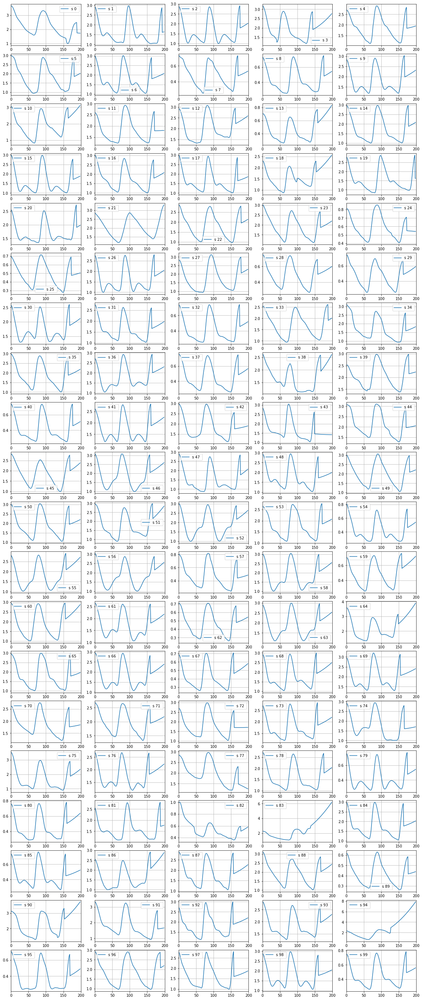

In [210]:
#ploting dataset test (they have same length)
i=0

fig,ax=plt.subplots(20,5,figsize=(20,50))
for r in range(0,20):
    for c in range(0,5):
        if i<len(arr):
            ax[r,c].plot(arr[i])
            ax[r,c].grid(True)
            ax[r,c].legend(['s %d '%(i)])
            ax[r,c].set_xlim(0,200)
            #ax[r,c].set_ylim(1,3)
        i=i+1
        

In [211]:
# Data test 
sample=['sample'+str(i) for i in range(0,len(data_test))]
p=['p'+str(i) for i in range(0,max(length))]
data_=pd.DataFrame(columns=[*p])
for i in range(0,len(data_test)):
    for j in range(0,len(arr[i])):
        data_.loc[i,'p'+str(j)]=arr[i][j]
    

#print(data.head())
#print(data.shape)
data_

,p0,p1,p2,p3,p4,p5,p6,p7,p8,p9,...,p189,p190,p191,p192,p193,p194,p195,p196,p197,p198
0,3.66373,3.65885,3.64712,3.62659,3.59726,3.55914,3.5132,3.46139,3.40567,3.34311,...,1.74816,1.74557,1.74301,1.74049,1.73801,1.73557,1.73317,1.73081,1.72849,1.72621
1,2.91984,2.9042,2.86901,2.8172,2.75269,2.67742,2.59629,2.50929,2.42033,2.32747,...,2.61193,2.73021,2.81623,2.86901,1.61671,1.62182,1.627,1.63226,1.63759,1.64299
2,2.86804,2.86119,2.83773,2.80254,2.75464,2.69599,2.62757,2.55132,2.46823,2.37928,...,1.91964,1.93055,1.94157,1.95272,1.96398,1.97536,1.98687,1.99849,2.01023,2.02209
3,3.17791,3.17107,3.14761,3.11241,3.06745,3.0176,2.96188,2.89834,2.82796,2.75269,...,2.57268,2.59229,2.61211,2.63214,2.65239,2.67284,2.69351,2.71439,2.73548,2.75679
4,2.69892,2.69892,2.68915,2.67058,2.64809,2.6217,2.59238,2.56012,2.52395,2.48289,...,1.89948,1.90392,1.90843,1.91301,1.91764,1.92234,1.92711,1.93194,1.93683,1.94179
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.705767,0.705767,0.699902,0.690127,0.677419,0.662757,0.647116,0.631476,0.617791,0.605083,...,0.460254,0.463401,0.466583,0.469802,0.473056,0.476347,0.479673,0.483035,0.486433,0.489868
96,2.92669,2.9218,2.90616,2.87879,2.83969,2.78886,2.73021,2.66471,2.59531,2.53079,...,2.09504,2.10572,2.11651,2.12743,2.13847,2.14964,2.16092,2.17233,2.18386,2.19551
97,2.77713,2.76637,2.72825,2.6696,2.59922,2.52493,2.45259,2.38416,2.3216,2.26491,...,1.79612,1.80395,1.81187,1.81989,1.828,1.83622,1.84453,1.85294,1.86144,1.87004
98,2.87879,2.86804,2.83871,2.79472,2.74096,2.67937,2.61779,2.55718,2.49071,2.42033,...,1.9634,1.97166,1.98001,1.98845,1.99699,2.00562,2.01434,2.02316,2.03206,2.04107


In [212]:
#PCA
# Separating out the features
x = data_.loc[:, p].values
# Standardizing the features
x = StandardScaler().fit_transform(x)
N=10
pca = PCA(n_components=N)
principalComponents = pca.fit_transform(x)
feature_pca=['pca'+str(i) for i in range(0,N)]
principalDf = pd.DataFrame(data = principalComponents, columns = [*feature_pca])
test =principalDf.loc[0:, feature_pca].values
principalDf

,pca0,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9
0,-15.707001,-9.058171,4.182395,2.899366,-2.212696,1.173514,-0.561317,-0.684351,1.106418,-0.654542
1,-2.226451,-3.260201,5.196246,4.647413,-0.787751,0.047518,-1.173220,-2.522487,-1.618970,2.306611
2,-1.807721,-0.580196,1.497547,1.428010,4.633377,0.859746,-1.994494,0.743469,1.608740,1.221183
3,-10.825982,1.911119,-7.456229,11.790085,2.377806,-1.109166,4.409855,-0.404948,1.053480,-1.859039
4,-7.442338,-3.709964,3.849380,-0.246345,0.275977,-0.928392,0.358821,2.045890,-0.300401,-0.105988
...,...,...,...,...,...,...,...,...,...,...
95,23.968795,1.335478,0.628758,-0.210046,0.573846,0.186245,0.434475,-0.327473,-0.454445,0.016888
96,-6.494711,-2.926314,6.877178,0.048507,-0.621903,1.853265,-0.514107,-0.325290,0.951582,-1.626259
97,-1.748478,-1.312993,-1.690859,-1.959127,-1.454049,0.969703,-0.241305,-1.531553,-0.011145,-0.776932
98,-4.039343,-0.660732,-3.455792,-1.283605,0.047115,-1.195131,-2.739156,-0.568930,0.942114,-0.047208


In [213]:
# Fitting Linear Regression to the dataset
print('Iteration 5,Systolic/BEST MODEL')
print('------------------------------------------')
print('\n')
# Fitting Linear Regression to the dataset
from sklearn.linear_model import LinearRegression
lin = LinearRegression() 
lin.fit(x5_Train, y5_Train)
y_lin_pred=lin.predict(x5_test)
y_predicted=lin.predict(test)
for i in range(0,len(y_predicted)):
    print("Sample %d : Systolic=%f"%(i,y_predicted[i]))
    print('\n')

# saving data
s1_predicted=y_predicted

# Fitting Polynomial Regression to the dataset
#from sklearn.preprocessing import PolynomialFeatures 
#poly = PolynomialFeatures(degree = 2)
#X_poly = poly.fit_transform(x5_Train)
#poly.fit(X_poly, y5_Train)
#lin2 = LinearRegression()
#lin2.fit(X_poly, y5_Train)
#X_poly_test = poly.fit_transform(x5_test)
#y_poly_pred = lin2.predict(X_poly_test)
#X_poly_test_ = poly.fit_transform(test)
#j = lin2.predict(X_poly_test_)
#for i in range(0,len(y_predicted)):
   # print("Sample %d : Systolic=%f"%(i,j[i]))
   # print('\n')

Iteration 5,Systolic/BEST MODEL
------------------------------------------


Sample 0 : Systolic=131.622826


Sample 1 : Systolic=131.148262


Sample 2 : Systolic=120.140924


Sample 3 : Systolic=122.404011


Sample 4 : Systolic=130.962573


Sample 5 : Systolic=130.835151


Sample 6 : Systolic=133.271574


Sample 7 : Systolic=128.221602


Sample 8 : Systolic=127.133620


Sample 9 : Systolic=131.153936


Sample 10 : Systolic=136.308765


Sample 11 : Systolic=133.490756


Sample 12 : Systolic=136.290093


Sample 13 : Systolic=128.059944


Sample 14 : Systolic=126.595910


Sample 15 : Systolic=121.489427


Sample 16 : Systolic=129.446512


Sample 17 : Systolic=126.130144


Sample 18 : Systolic=132.327357


Sample 19 : Systolic=135.823493


Sample 20 : Systolic=131.028255


Sample 21 : Systolic=140.188706


Sample 22 : Systolic=131.010451


Sample 23 : Systolic=132.565211


Sample 24 : Systolic=129.354367


Sample 25 : Systolic=128.805418


Sample 26 : Systolic=123.409181


Sample 27 : Sys